# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [3]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [4]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [5]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [6]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

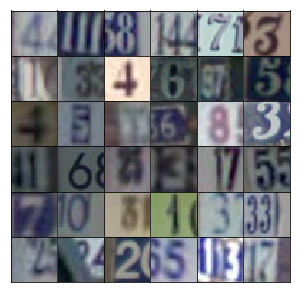

In [7]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [8]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [9]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [10]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [11]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1,(-1,4,4,512))
        x1 = tf.layers.batch_normalization(x1, trainable=training)
        x1 = tf.maximum(alpha*x1, x1)
        
        #First Layer, 4*4*512
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, trainable=training)
        x2 = tf.maximum(alpha*x2, x2)
        
        #Second Layer 8*8*256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, trainable=training)
        x3 = tf.maximum(alpha*x3, x3)
        
        #Third Layer 16*16*128
        
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, trainable=training)
        # Output layer, 32x32x3
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [12]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x1 = tf.maximum(alpha*x1, x1)
        
        #Layer 1 16*16*64
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, trainable=True)
        x2 = tf.maximum(alpha*x2, x2)
        
        #Layer 2 8*8*128
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, trainable=True)
        x3 = tf.maximum(alpha*x3, x3)
        
        #Layer 3 4*4*256
        
        #Flattening it
        
        flat = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [13]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [14]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [15]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [16]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [17]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [18]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.7495... Generator Loss: 0.8058
Epoch 1/25... Discriminator Loss: 0.6172... Generator Loss: 0.8212
Epoch 1/25... Discriminator Loss: 0.2700... Generator Loss: 1.5462
Epoch 1/25... Discriminator Loss: 0.0531... Generator Loss: 3.2636
Epoch 1/25... Discriminator Loss: 0.0215... Generator Loss: 4.3127
Epoch 1/25... Discriminator Loss: 0.0089... Generator Loss: 5.0602
Epoch 1/25... Discriminator Loss: 0.0067... Generator Loss: 5.4788
Epoch 1/25... Discriminator Loss: 0.0043... Generator Loss: 5.9102
Epoch 1/25... Discriminator Loss: 0.0042... Generator Loss: 6.1909
Epoch 1/25... Discriminator Loss: 0.0018... Generator Loss: 6.7690


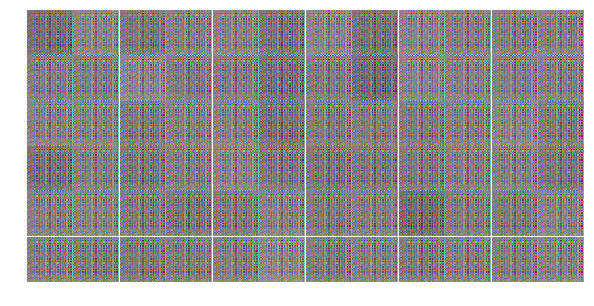

Epoch 1/25... Discriminator Loss: 0.0023... Generator Loss: 6.7490
Epoch 1/25... Discriminator Loss: 0.0013... Generator Loss: 6.9934
Epoch 1/25... Discriminator Loss: 0.0011... Generator Loss: 7.1365
Epoch 1/25... Discriminator Loss: 0.0017... Generator Loss: 7.2590
Epoch 1/25... Discriminator Loss: 0.0010... Generator Loss: 7.5262
Epoch 1/25... Discriminator Loss: 0.0009... Generator Loss: 7.6307
Epoch 1/25... Discriminator Loss: 0.0011... Generator Loss: 7.7856
Epoch 1/25... Discriminator Loss: 0.0005... Generator Loss: 8.0128
Epoch 1/25... Discriminator Loss: 0.0005... Generator Loss: 8.1423
Epoch 1/25... Discriminator Loss: 0.0004... Generator Loss: 8.2538


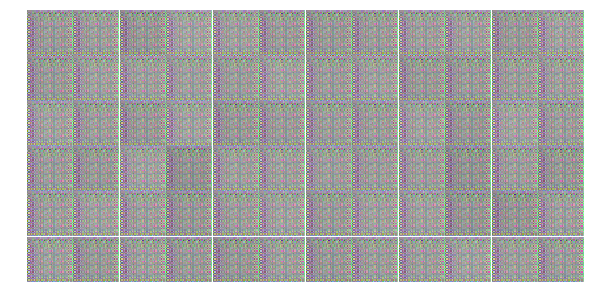

Epoch 1/25... Discriminator Loss: 0.0008... Generator Loss: 8.3807
Epoch 1/25... Discriminator Loss: 0.0004... Generator Loss: 8.3427
Epoch 1/25... Discriminator Loss: 0.0007... Generator Loss: 8.4411
Epoch 1/25... Discriminator Loss: 0.0003... Generator Loss: 8.8371
Epoch 1/25... Discriminator Loss: 0.0011... Generator Loss: 8.6503
Epoch 1/25... Discriminator Loss: 0.0003... Generator Loss: 8.6938
Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 8.9320
Epoch 1/25... Discriminator Loss: 0.0003... Generator Loss: 8.9824
Epoch 1/25... Discriminator Loss: 0.0005... Generator Loss: 8.9952
Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 9.1383


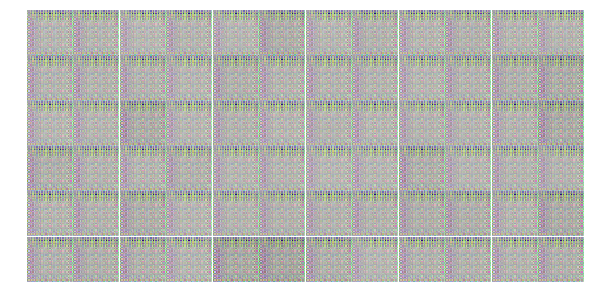

Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 9.2387
Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 9.3424
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 9.4169
Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 9.3399
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 9.4786
Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 9.2346
Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 9.4980
Epoch 1/25... Discriminator Loss: 0.0004... Generator Loss: 9.7143
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 9.6139
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 9.8303


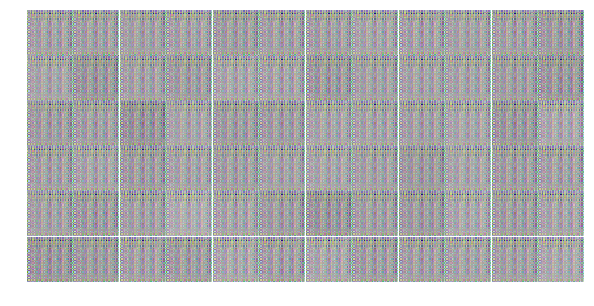

Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 9.9151
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 9.9949
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.0319
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 9.9946
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.0222
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.1257
Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 10.1474
Epoch 1/25... Discriminator Loss: 0.0002... Generator Loss: 10.1319
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.2540
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.2366


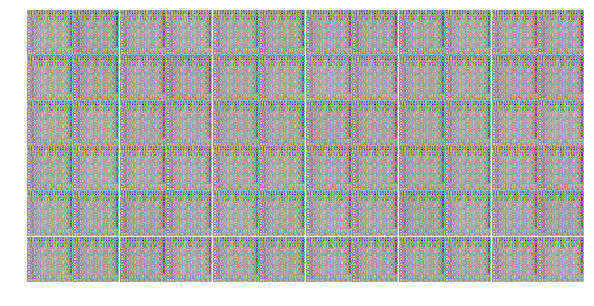

Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.3406
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.3758
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.4309
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.4819
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.5263
Epoch 1/25... Discriminator Loss: 0.0000... Generator Loss: 10.6476
Epoch 1/25... Discriminator Loss: 0.0001... Generator Loss: 10.7137
Epoch 2/25... Discriminator Loss: 0.0001... Generator Loss: 10.7413
Epoch 2/25... Discriminator Loss: 0.0001... Generator Loss: 10.6411
Epoch 2/25... Discriminator Loss: 0.0002... Generator Loss: 10.6495


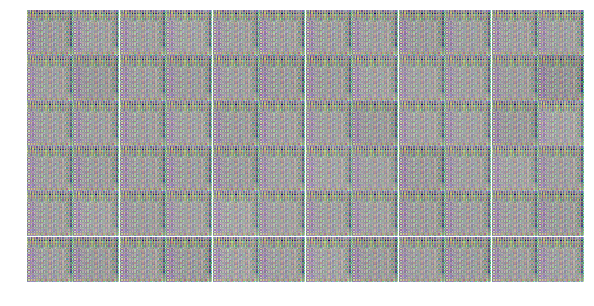

Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.6783
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.5572
Epoch 2/25... Discriminator Loss: 0.0002... Generator Loss: 10.5662
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.5418
Epoch 2/25... Discriminator Loss: 0.0001... Generator Loss: 10.6725
Epoch 2/25... Discriminator Loss: 0.0001... Generator Loss: 10.7756
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.8025
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.9128
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.9186
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.8258


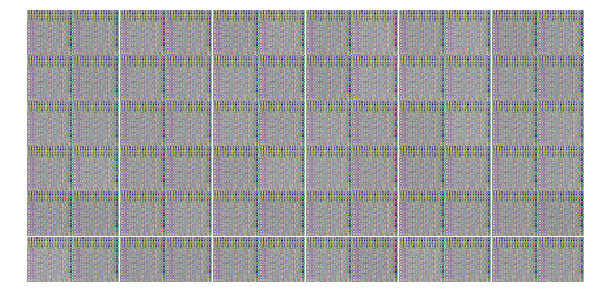

Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.6445
Epoch 2/25... Discriminator Loss: 0.0002... Generator Loss: 10.7258
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.8463
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.9133
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 10.9953
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.0840
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.1644
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.2216
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.2166
Epoch 2/25... Discriminator Loss: 0.0002... Generator Loss: 11.1969


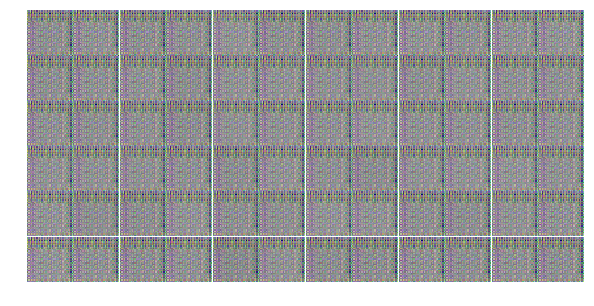

Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.1940
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.2547
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.1937
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.2888
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.3831
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.4239
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.4352
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.4771
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.5513
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.5773


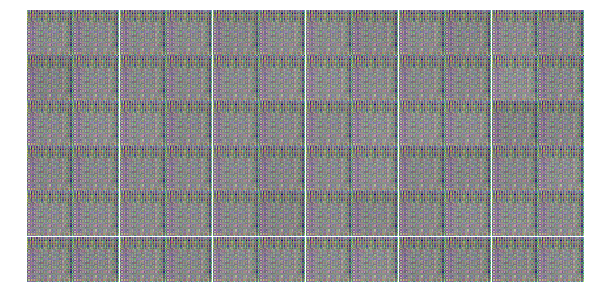

Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.5324
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.6102
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.3308
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.4048
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.5348
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.4628
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.5153
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.6219
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.6916
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.7630


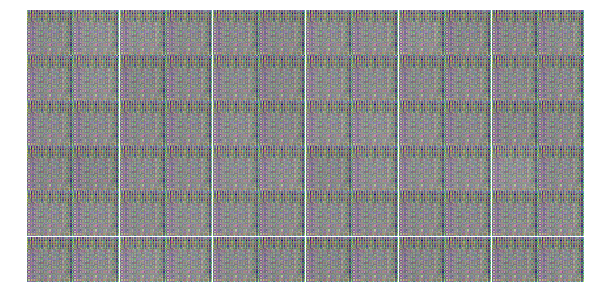

Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.7062
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.7875
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.8545
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.9271
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.8829
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.8697
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.9431
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.9013
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.9844
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.9279


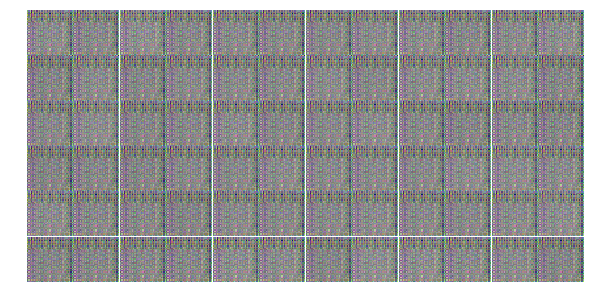

Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 11.9793
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 12.0218
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 12.0846
Epoch 2/25... Discriminator Loss: 0.0000... Generator Loss: 12.1641
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2095
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2243
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2063
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2018
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2729
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.1101


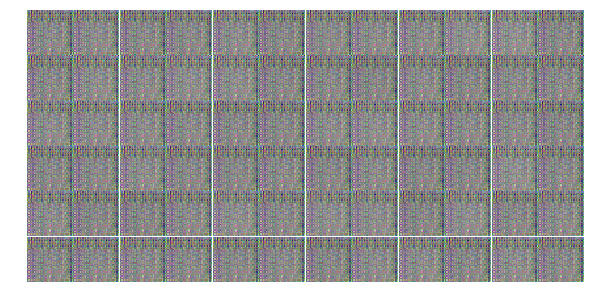

Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.0516
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.1120
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.1843
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2274
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2809
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.3207
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2395
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2325
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.0201
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.1006


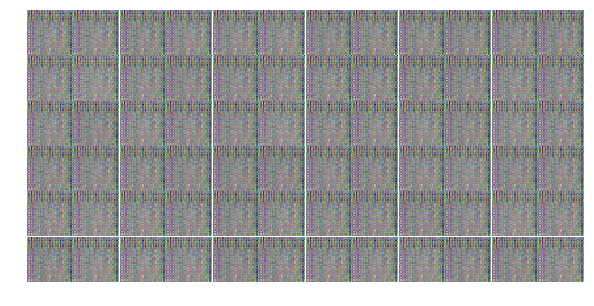

Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.1695
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.2261
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.3269
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.3720
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.4408
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.4460
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.5141
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.4296
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.5009
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.4632


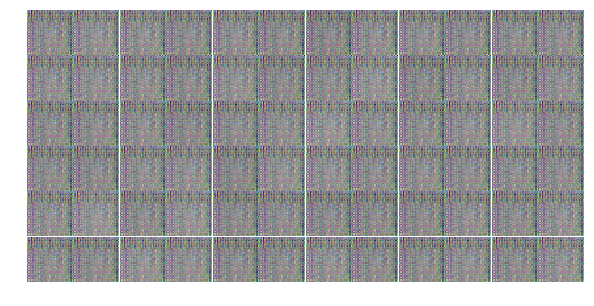

Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.4849
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.5618
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.6029
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.6298
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.6735
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7122
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7472
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7277
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7713
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7975


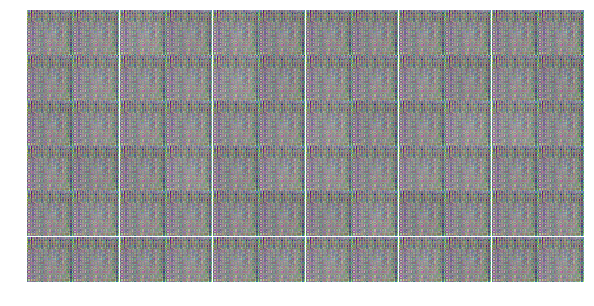

Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.5693
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.6565
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7065
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.5957
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.6792
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7416
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7948
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.7589
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.8115
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.8666


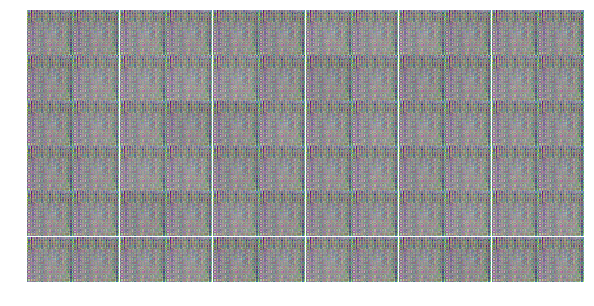

Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.9206
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.9088
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.8754
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.9447
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.9148
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.9562
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.9103
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.9579
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 12.9789
Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 13.0413


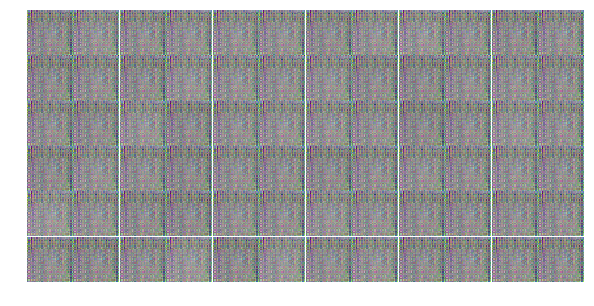

Epoch 3/25... Discriminator Loss: 0.0000... Generator Loss: 13.0995
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1473
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1754
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1449
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1523
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2036
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.0792
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.0414
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.0475
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1014


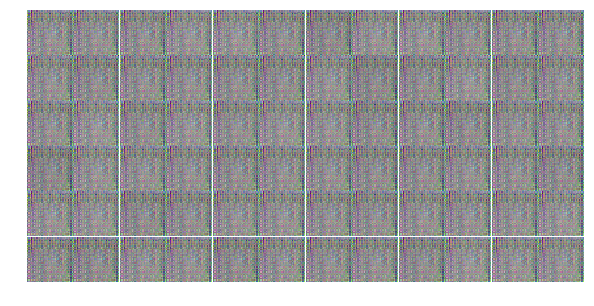

Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1525
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1804
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2305
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1637
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1746
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 12.8728
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 12.9265
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 12.9789
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.0425
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.0983


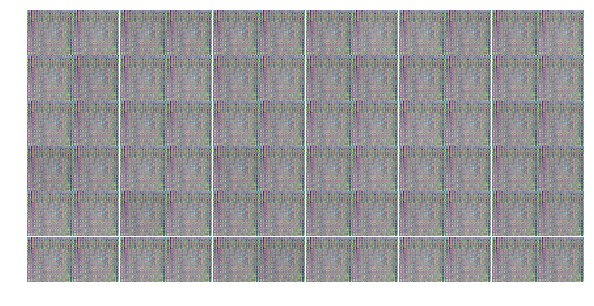

Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.1424
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2060
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2439
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2908
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2551
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2954
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2672
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.2764
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.3537
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.3986


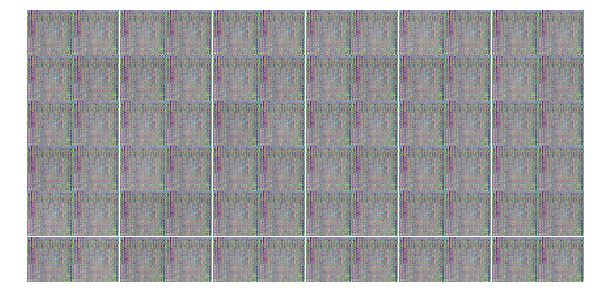

Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.4218
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.4567
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.4877
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.5298
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.5738
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.5453
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.5912
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.3680
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.4245
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.4679


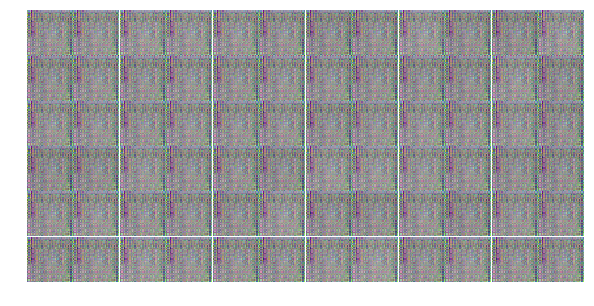

Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.3601
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.4212
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.4793
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.5382
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.5771
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.5398
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.5938
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.6578
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.6486
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.6440


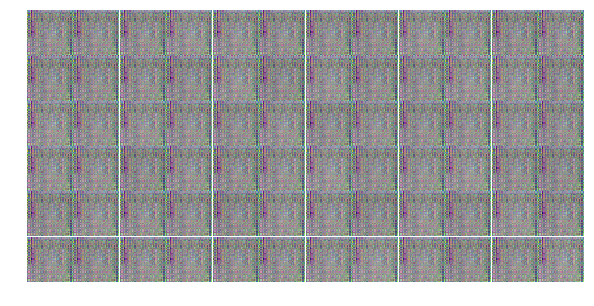

Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.6715
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.6528
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.6927
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.6705
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.7020
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.7359
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.7527
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.8164
Epoch 4/25... Discriminator Loss: 0.0000... Generator Loss: 13.8595
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9011


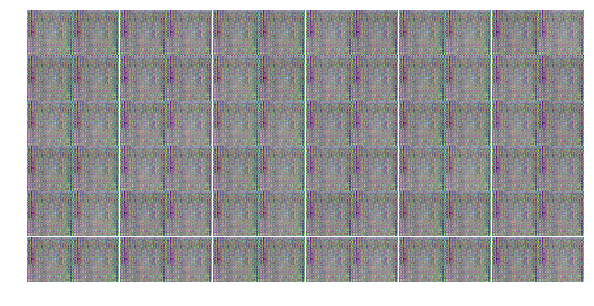

Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8622
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8721
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9157
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8117
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8010
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.7761
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8209
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8616
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8928
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9408


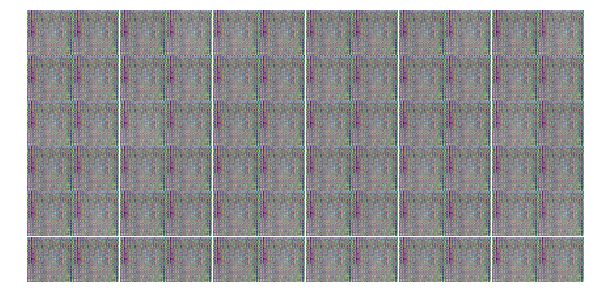

Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9548
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8804
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.6017
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.6027
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.6644
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.7212
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.7629
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8199
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.8770
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9369


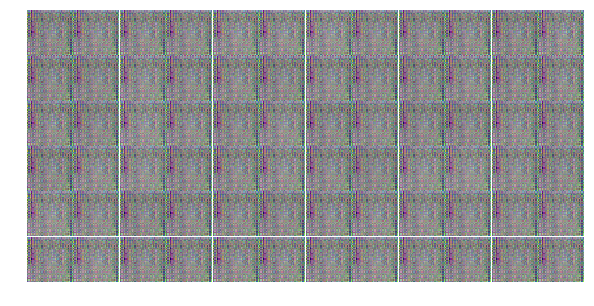

Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9609
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9579
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9701
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9886
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 13.9755
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.0241
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.0675
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.1001
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.1285
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.1508


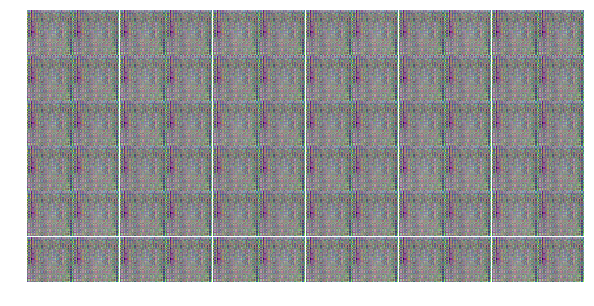

Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.2004
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.2299
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.2211
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.2590
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.0607
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.0940
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.1482
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.0451
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.0759
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.1316


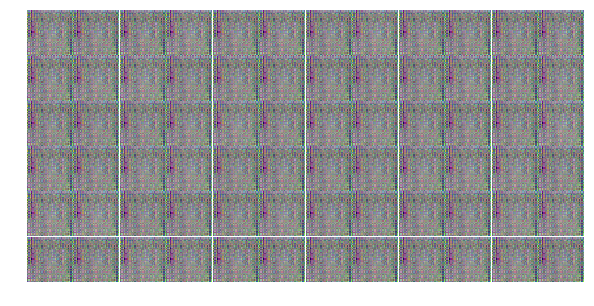

Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.1817
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.2295
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.1855
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.2402
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.2803
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3320
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3125
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3120
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3241
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3198


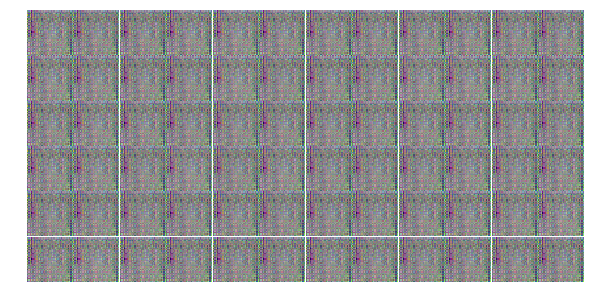

Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3735
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3336
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3606
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.3748
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.4288
Epoch 5/25... Discriminator Loss: 0.0000... Generator Loss: 14.4763
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5105
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5370
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5154
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5245


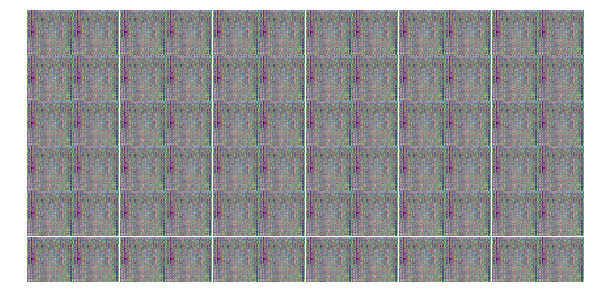

Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5557
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.4596
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.4030
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.4439
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.4836
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5044
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5419
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5695
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5002
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.4946


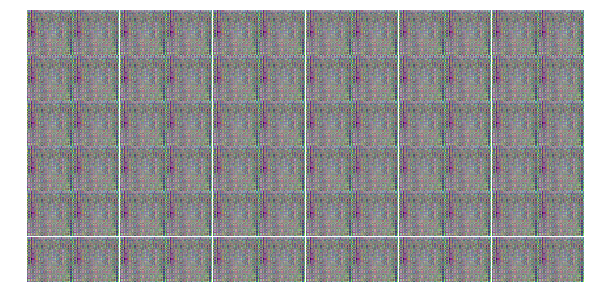

Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.2241
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.2618
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.3149
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.3442
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.3973
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.4500
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5011
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5239
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5718
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5417


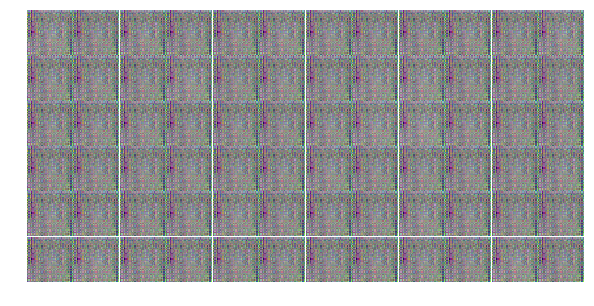

Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5853
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5563
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.5856
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.6326
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.6686
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.6935
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7237
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7565
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7884
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7876


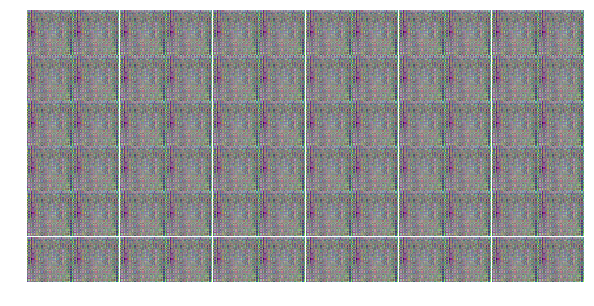

Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.8223
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7474
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.6742
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7212
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7520
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.6399
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.6933
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7357
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7775
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7471


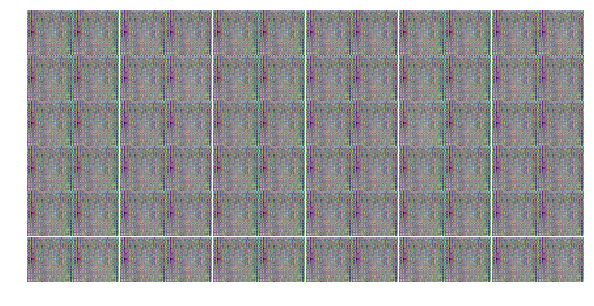

Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.7911
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.8272
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.8714
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.8601
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.8569
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.8953
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.8807
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.9135
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.8751
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.9028


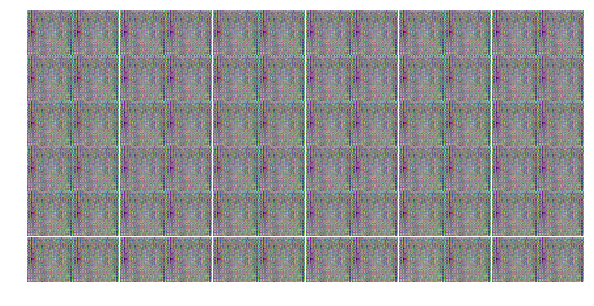

Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.9104
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 14.9555
Epoch 6/25... Discriminator Loss: 0.0000... Generator Loss: 15.0006
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0362
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0658
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0391
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0510
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0951
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.9974
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.9698


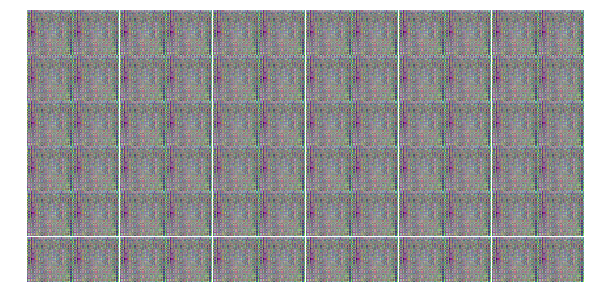

Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.9795
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0131
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0506
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0716
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.1132
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0560
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0462
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.7459
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.7716
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.8123


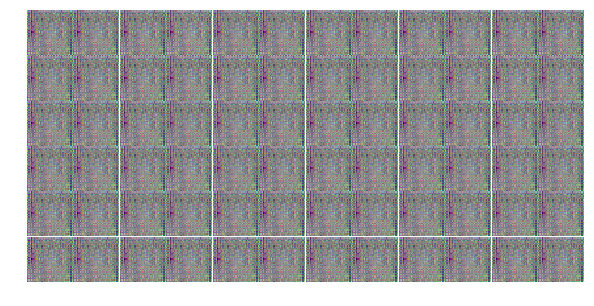

Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.8590
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.9088
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.9488
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 14.9964
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0287
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0694
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0433
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0944
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0742
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.0942


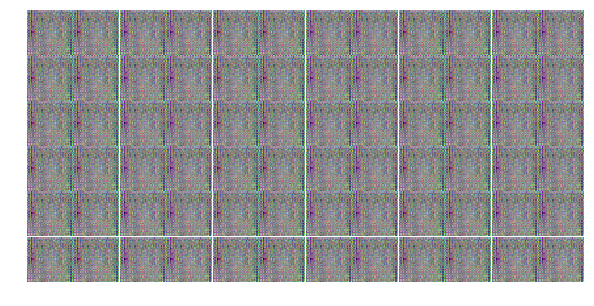

Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.1367
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.1728
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.1954
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.2396
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.2607
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.2888
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3161
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3206
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3558
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.1972


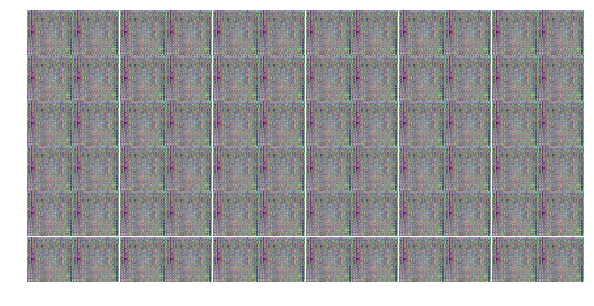

Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.2336
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.2663
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.1461
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.1888
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.2298
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.2773
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3107
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.2814
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3168
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3620


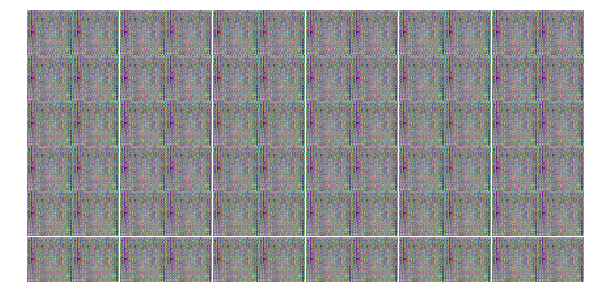

Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3565
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3494
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3863
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3705
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3921
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.3670
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.4027
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.4254
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.4384
Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.4809


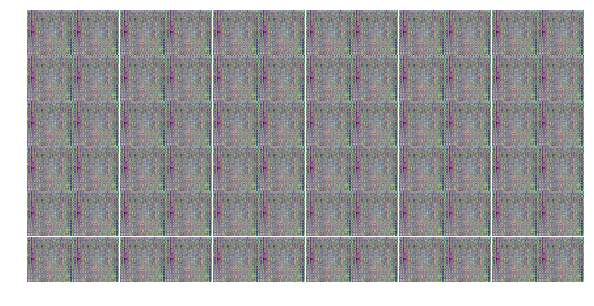

Epoch 7/25... Discriminator Loss: 0.0000... Generator Loss: 15.5137
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5526
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5193
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5310
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5698
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.4838
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.4799
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.4623
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.4977
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5280


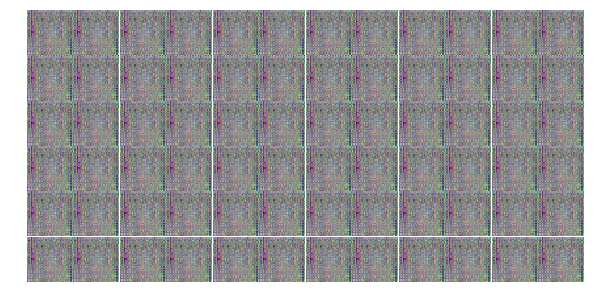

Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5531
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5899
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5711
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5466
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.2233
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.2374
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.2803
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.3218
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.3671
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.4075


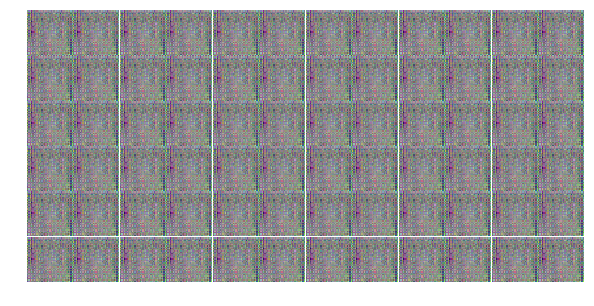

Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.4520
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.4984
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5271
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5218
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5455
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5632
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5621
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.5937
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.6381
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.6672


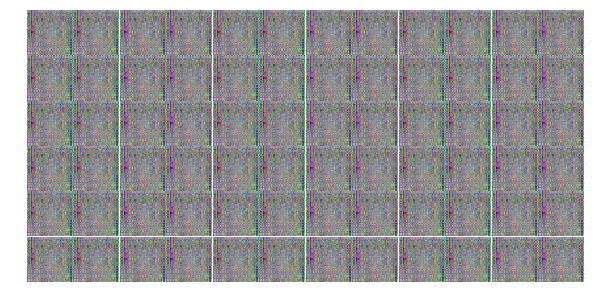

Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.6841
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7139
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7479
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7758
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7785
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8205
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.6676
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7015
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7380
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.6186


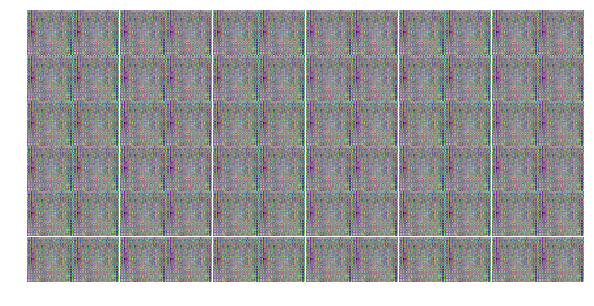

Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.6510
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.6926
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7315
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7633
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7335
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.7735
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8147
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8374
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8352
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8357


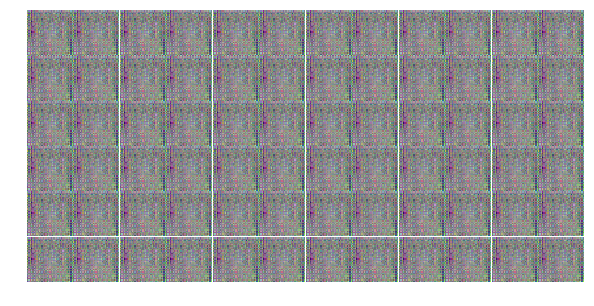

Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8382
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8506
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8572
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8559
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8791
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.8856
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.9233
Epoch 8/25... Discriminator Loss: 0.0000... Generator Loss: 15.9692
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9958
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9906


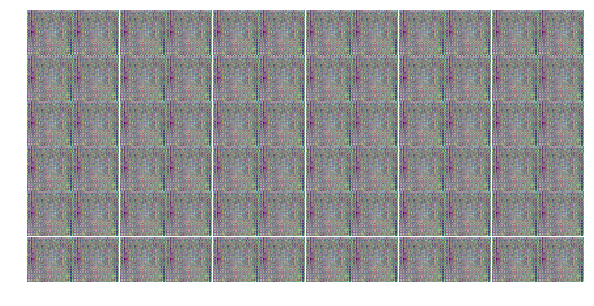

Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9979
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0066
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9803
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9598
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9144
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9482
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9777
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0024
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0346
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0578


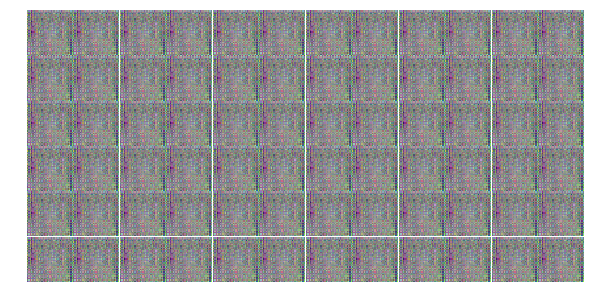

Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9932
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.8180
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.7009
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.7266
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.7581
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.7973
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.8357
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.8825
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9288
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9533


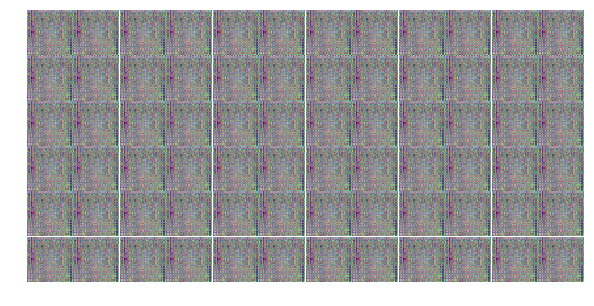

Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9907
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9697
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0008
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 15.9956
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0237
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0642
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0954
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1230
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1451
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1819


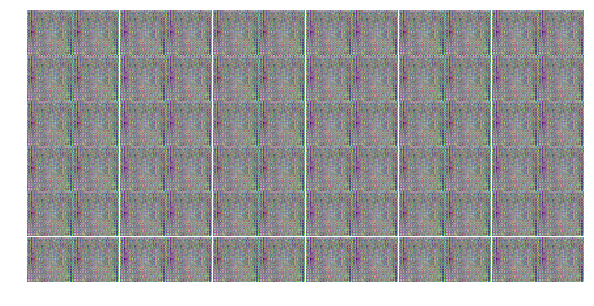

Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2061
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2131
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2416
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1479
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1377
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1738
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1214
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.0815
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1202
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1570


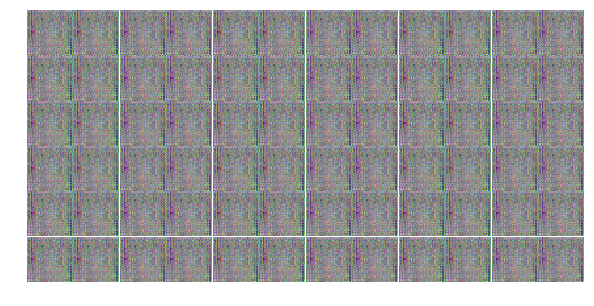

Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1939
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.1655
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2001
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2348
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2756
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2657
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2650
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.3002
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2788
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.3063


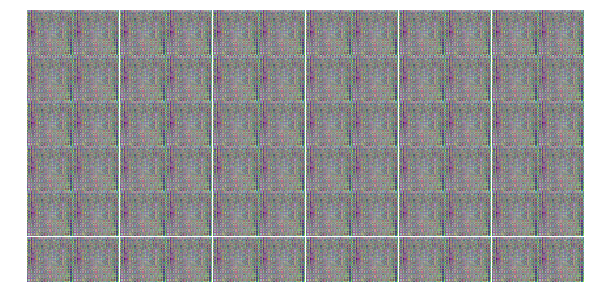

Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.2779
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.3020
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.3076
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.3401
Epoch 9/25... Discriminator Loss: 0.0000... Generator Loss: 16.3812
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4125
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4359
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4125
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4265
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4585


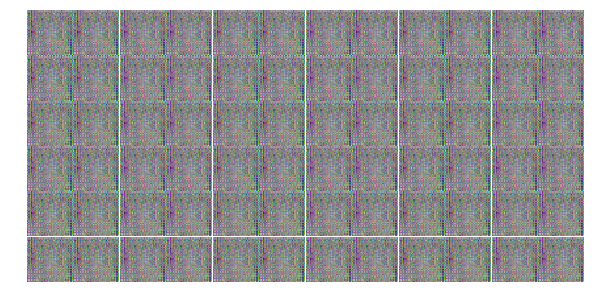

Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.3809
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.3541
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.3682
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4040
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4272
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4517
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4839
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4358
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4222
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.1083


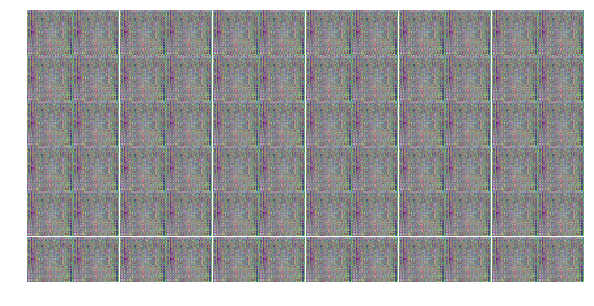

Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.1327
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.1662
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.2058
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.2481
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.2905
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.3278
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.3573
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.3948
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.3830
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4194


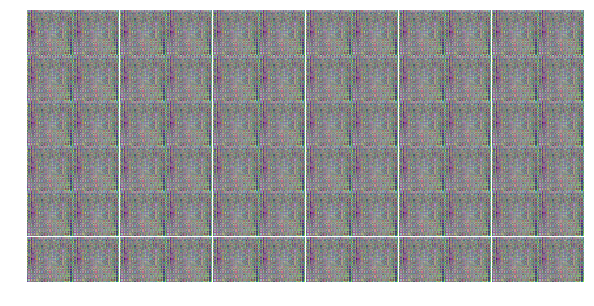

Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4115
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4274
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4686
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5004
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5280
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5643
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5856
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6130
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6252
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6506


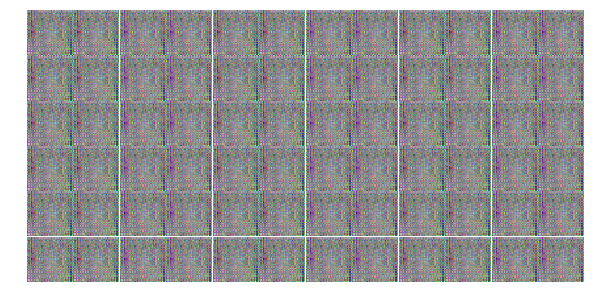

Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6799
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5516
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5871
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6106
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.4887
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5348
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5629
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6040
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.5940
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6085


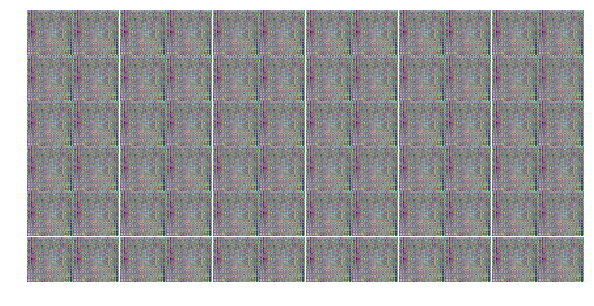

Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6400
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6742
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6691
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6692
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.7047
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6872
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.7081
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.6789
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.7042
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.7178


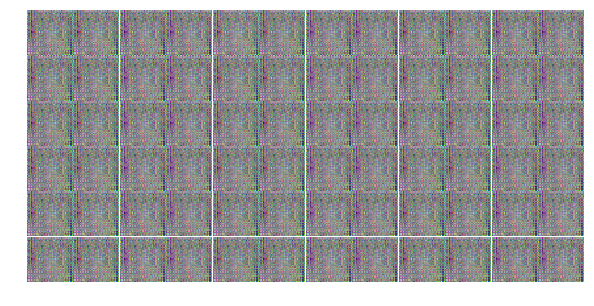

Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.7370
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.7755
Epoch 10/25... Discriminator Loss: 0.0000... Generator Loss: 16.8055
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8309
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8063
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8214
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8521
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.7799
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.7751
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.7655


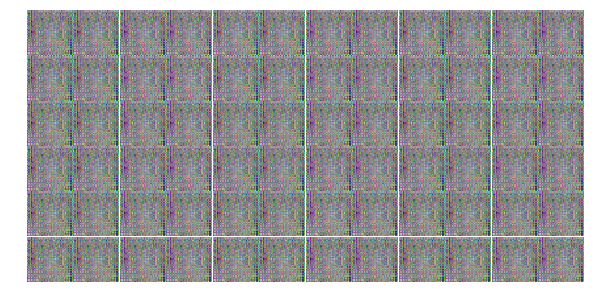

Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.7993
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8283
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8466
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8809
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8434
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8452
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.4983
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.5151
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.5515
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.5892


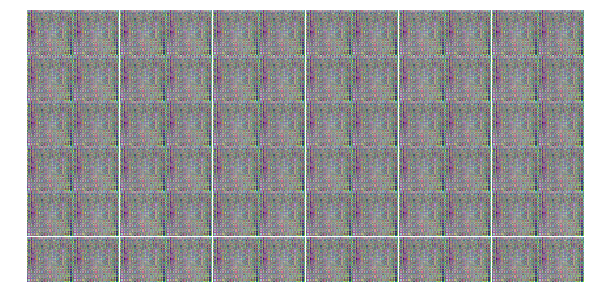

Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.6327
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.6664
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.7139
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.7518
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.7793
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.7750
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8074
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8092
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8211
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8603


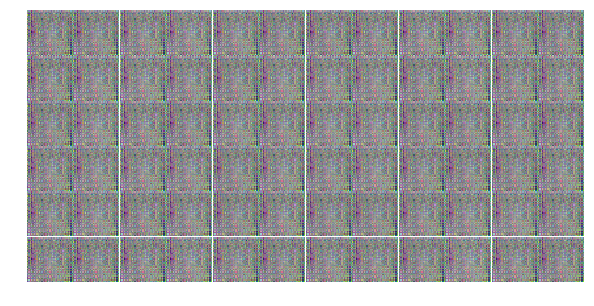

Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8960
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9179
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9498
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9765
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0060
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0349
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0418
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0734
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9503
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9770


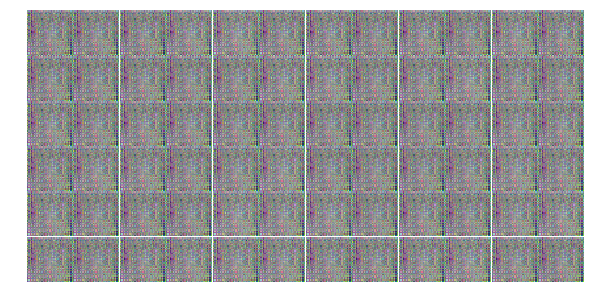

Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0050
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.8866
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9161
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9546
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9868
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0189
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 16.9934
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0226
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0652
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0717


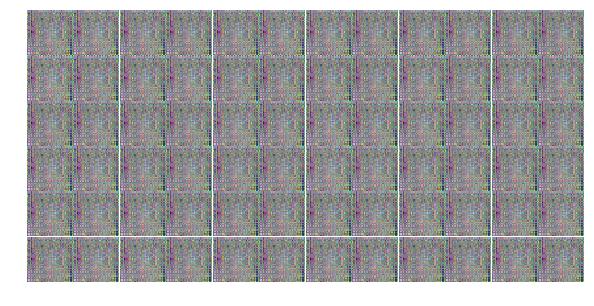

Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0846
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0903
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0791
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0966
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.0985
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.1012
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.1212
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.1262
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.1601
Epoch 11/25... Discriminator Loss: 0.0000... Generator Loss: 17.1951


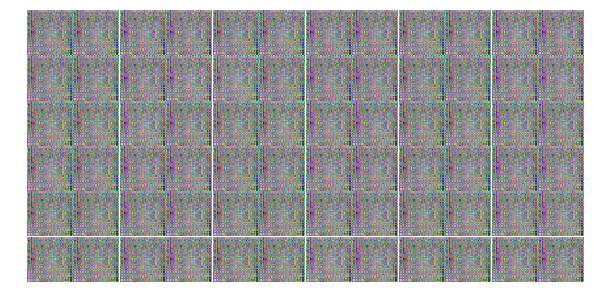

Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2254
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2051
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2128
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2393
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.1876
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.1834
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.1552
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.1906
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2221
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2416


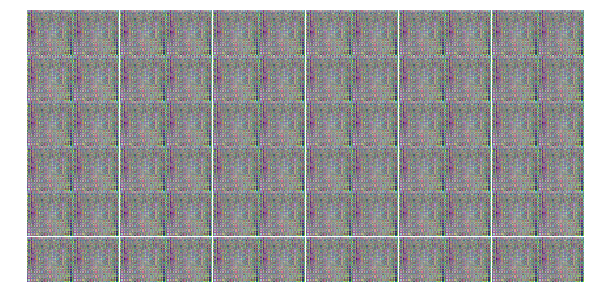

Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2728
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2915
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2352
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 16.9607
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 16.8992
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 16.9447
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 16.9695
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.0063
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.0449
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.0893


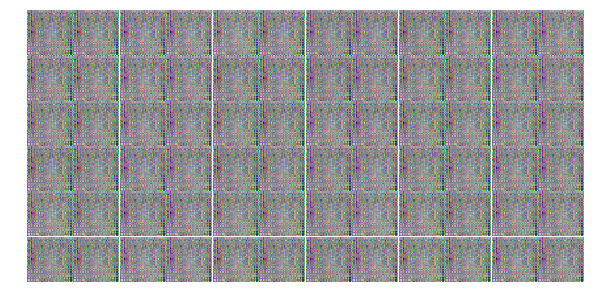

Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.1322
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.1601
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.1737
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.1806
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2005
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2093
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2384
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2732
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3043
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3305


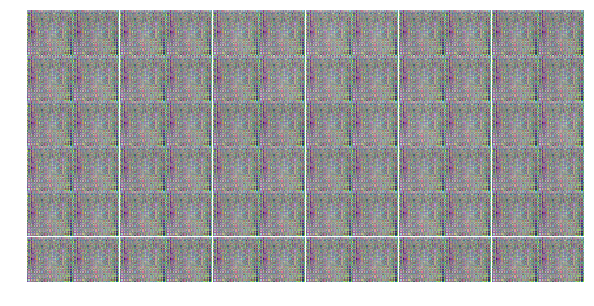

Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3522
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3886
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4134
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4268
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4533
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3534
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3656
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3932
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3044
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.2940


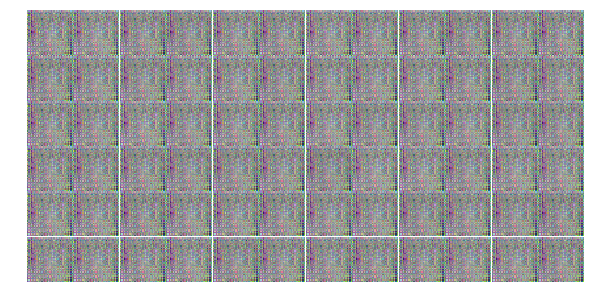

Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3326
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3629
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3997
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.3727
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4055
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4384
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4719
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4638
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4695
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.5004


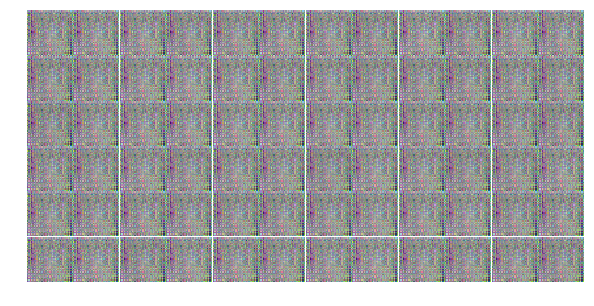

Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4824
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.5074
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.4789
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.5035
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.5054
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.5378
Epoch 12/25... Discriminator Loss: 0.0000... Generator Loss: 17.5708
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6020
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6216
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5971


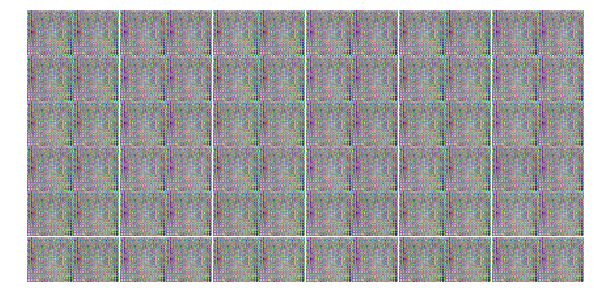

Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6157
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6467
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5749
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5442
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5635
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5964
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6190
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6452
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6737
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6219


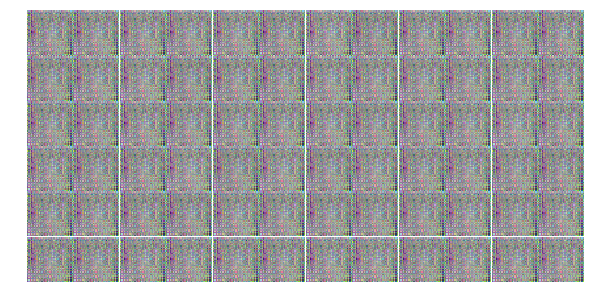

Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6152
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.2820
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.3090
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.3426
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.3785
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.4203
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.4569
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.4975
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5248
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5677


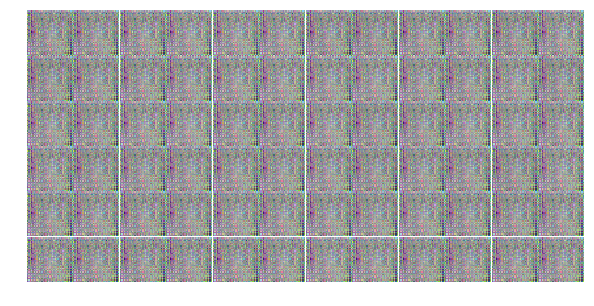

Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5520
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5942
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.5908
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6081
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6480
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6785
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7080
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7327
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7594
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7871


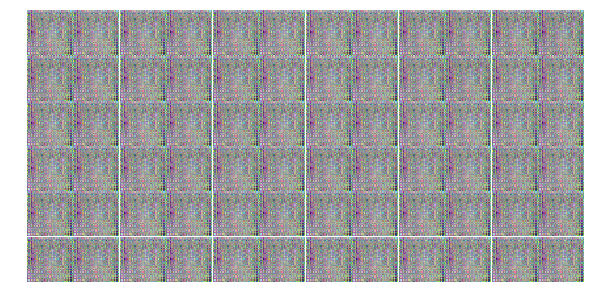

Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8006
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8292
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8550
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7393
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7787
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7945
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.6679
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7086
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7415
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7731


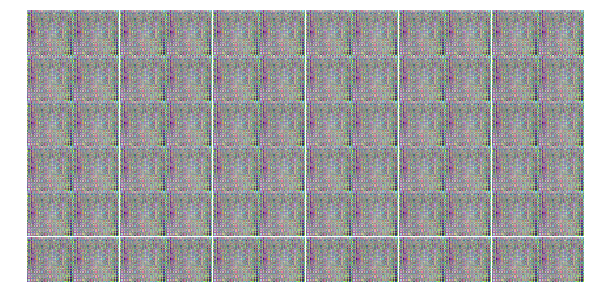

Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7564
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.7820
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8127
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8467
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8424
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8443
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8762
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8637
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8856
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8540


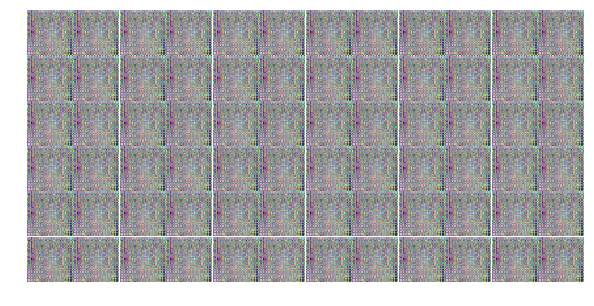

Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8778
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.8864
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.9086
Epoch 13/25... Discriminator Loss: 0.0000... Generator Loss: 17.9433
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9722
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9942
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9687
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9856
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0161
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9459


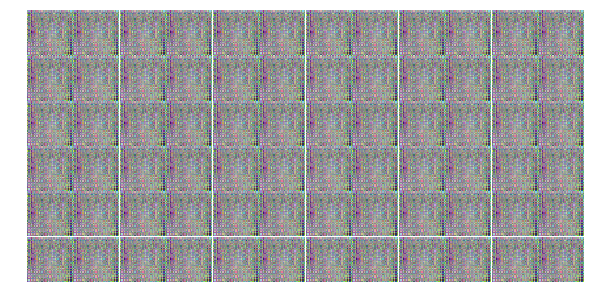

Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9311
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9408
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9723
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9987
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0224
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0495
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0057
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0149
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.6513
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.6726


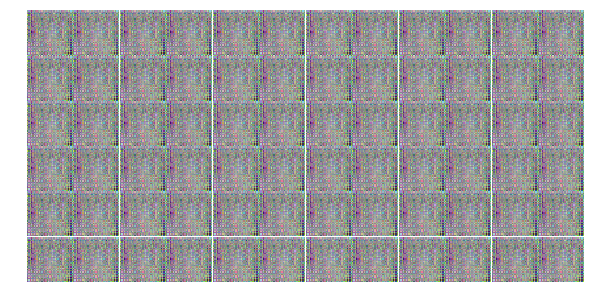

Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.6997
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.7403
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.7817
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.8140
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.8595
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.8916
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9237
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9279
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9594
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9569


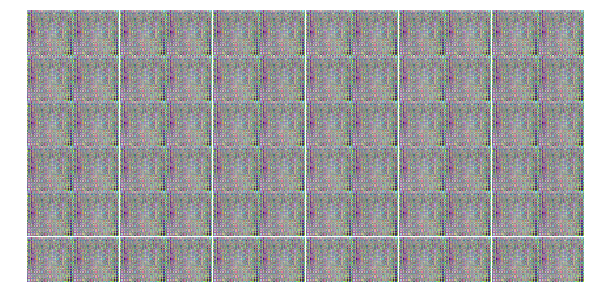

Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 17.9708
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0093
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0466
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0700
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0990
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1248
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1571
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1856
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1970
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2261


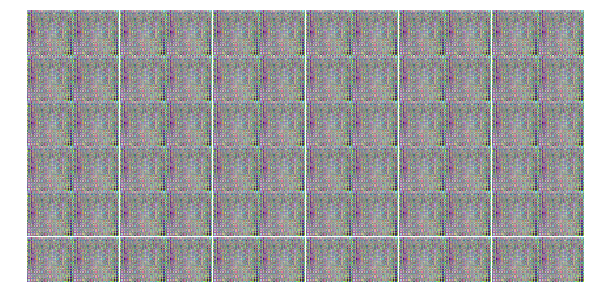

Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1169
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1471
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1716
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0375
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.0704
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1100
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1435
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1715
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1452
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.1850


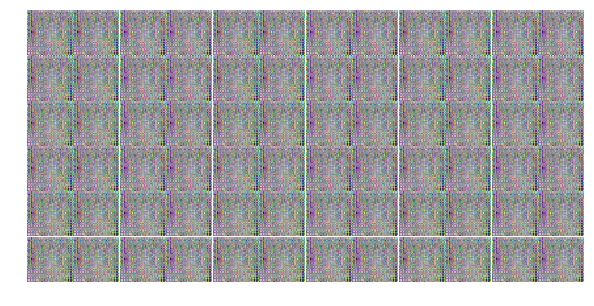

Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2117
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2104
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2199
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2369
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2213
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2472
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2295
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2514
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2734
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.2732


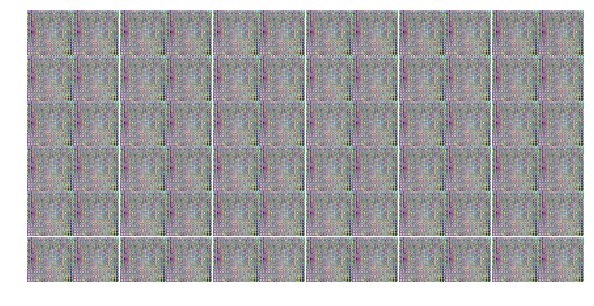

Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.3106
Epoch 14/25... Discriminator Loss: 0.0000... Generator Loss: 18.3417
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3669
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3430
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3547
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3797
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3185
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3191
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3097
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3417


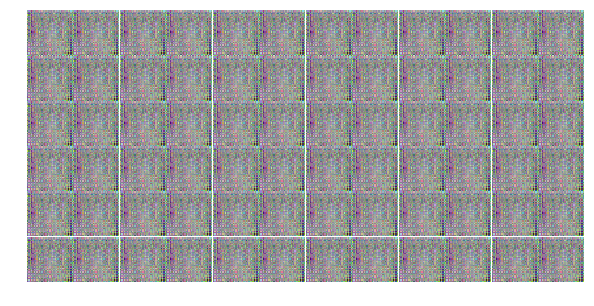

Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3647
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3859
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4143
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4340
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3842
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.0465
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.0257
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.0617
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.0987
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.1343


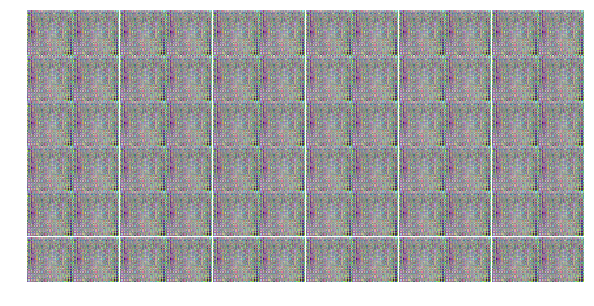

Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.1677
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.2139
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.2563
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.2823
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.2938
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3180
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3274
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3401
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.3702
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4058


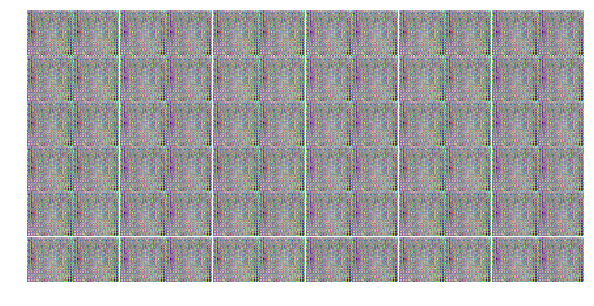

Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4324
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4666
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4895
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5238
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5495
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5584
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5882
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4866
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5069
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5384


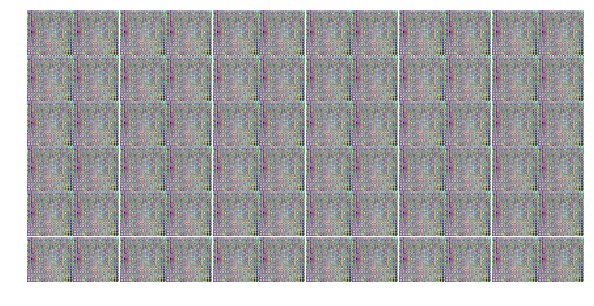

Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4220
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4347
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4727
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.4993
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5361
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5067
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5401
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5720
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6056
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.5926


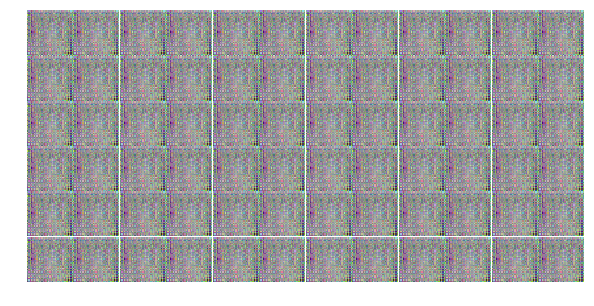

Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6007
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6123
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6106
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6526
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6158
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6346
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6376
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.6711
Epoch 15/25... Discriminator Loss: 0.0000... Generator Loss: 18.7029
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7340


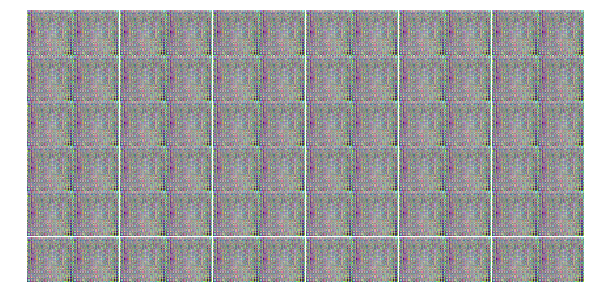

Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7572
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7247
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7476
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7693
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7066
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.6724
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7026
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7349
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7611
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7868


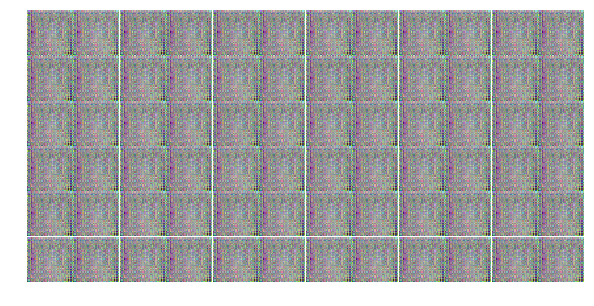

Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.8181
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7580
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7480
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.3801
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.4193
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.4775
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.5334
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.5977
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.6637
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7172


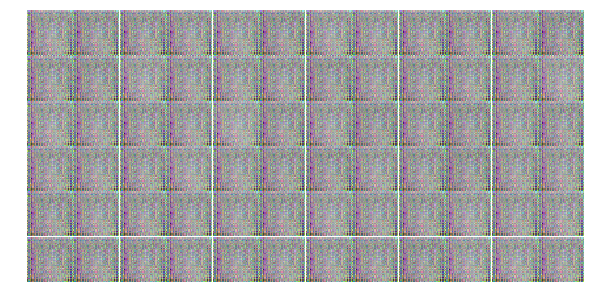

Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.7566
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.8048
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.8129
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.8597
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.8446
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.8851
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.9360
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.9643
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.9990
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0327


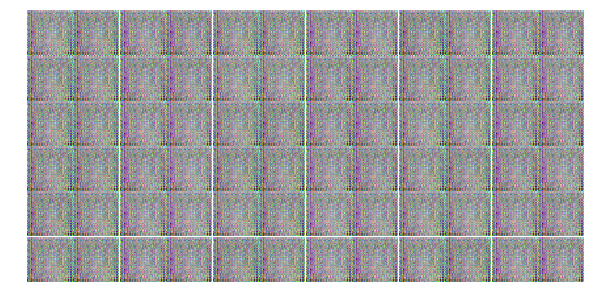

Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0695
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1019
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1114
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1434
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0753
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0059
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0511
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0770
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.9014
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.9546


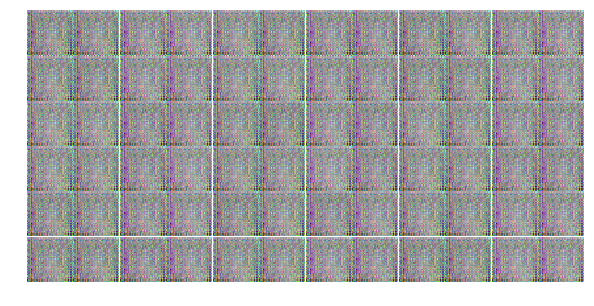

Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 18.9991
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0413
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0133
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0533
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.0954
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1333
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1251
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1285
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1726
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1456


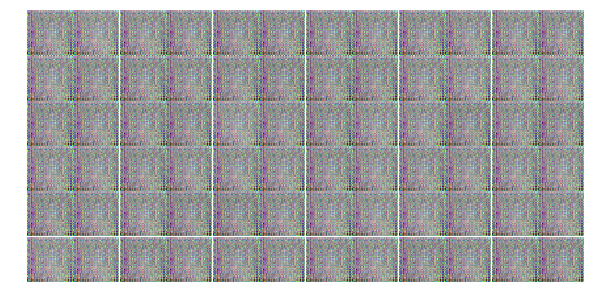

Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1741
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1419
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1706
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.1705
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.2090
Epoch 16/25... Discriminator Loss: 0.0000... Generator Loss: 19.2426
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2788
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3043
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2629
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2811


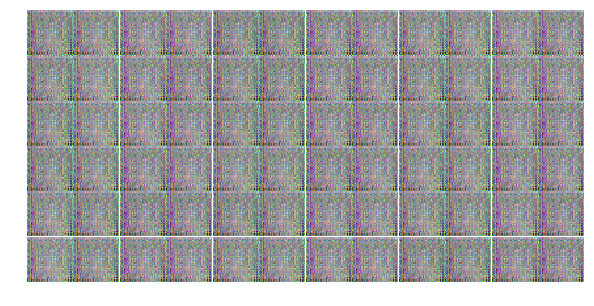

Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3222
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2369
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2117
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2275
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2645
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2973
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3267
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3639
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3013
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3049


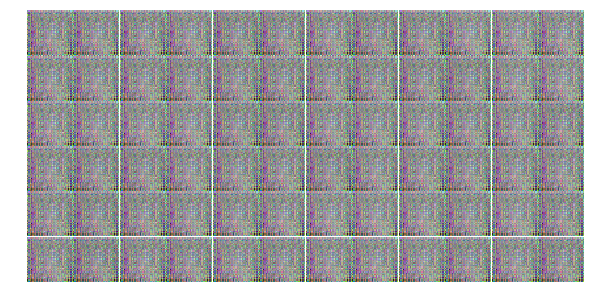

Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 18.8496
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 18.8971
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 18.9409
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 18.9997
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.0567
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.1015
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.1601
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.1927
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2448
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2428


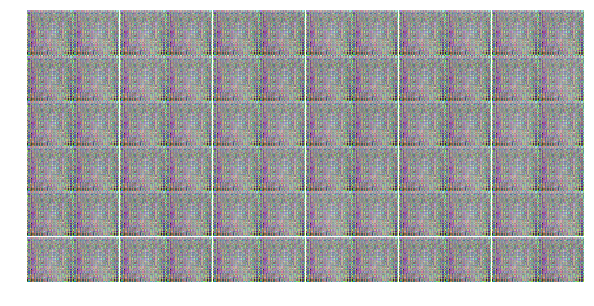

Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2839
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.2819
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3037
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3484
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3860
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.4181
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.4556
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.4839
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.5158
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.5469


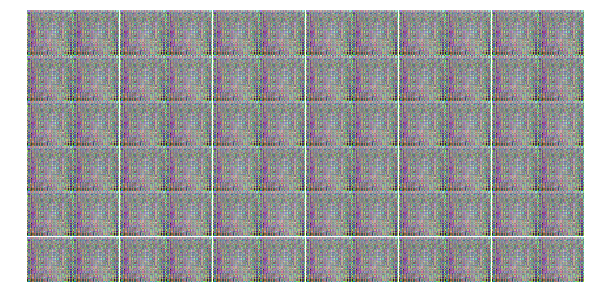

Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.5587
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.5936
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.4417
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.4807
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.5048
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3311
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.3745
Epoch 17/25... Discriminator Loss: 0.0000... Generator Loss: 19.4181


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))